In [1]:
import plotly.graph_objs as go      # For creating Plotly graph objects
import plotly.io as pio             # For rendering Plotly figures to save as HTML or images
import plotly.express as px         # For creating interactive plots with Plotly

import plotly.offline as py             # For offline plotting using Plotly
py.init_notebook_mode(connected=True)   # Initialize Plotly in offline mode

import pandas as pd
import matplotlib.pyplot as plt

Read data

In [2]:
# Importing Dataset1
dataset1 = pd.read_csv("covid.csv")
dataset1.head()  

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
0,USA,North America,3.311981e+08,5032179,NaN,162804.0,NaN,2576668.0,NaN,2292707.0,18296.0,15194.0,492.0,63139605.0,190640.0,Americas,USA
1,Brazil,South America,2.127107e+08,2917562,NaN,98644.0,NaN,2047660.0,NaN,771258.0,8318.0,13716.0,464.0,13206188.0,62085.0,Americas,BRA
2,India,Asia,1.381345e+09,2025409,NaN,41638.0,NaN,1377384.0,NaN,606387.0,8944.0,1466.0,30.0,22149351.0,16035.0,South-EastAsia,IND
3,Russia,Europe,1.459409e+08,871894,NaN,14606.0,NaN,676357.0,NaN,180931.0,2300.0,5974.0,100.0,29716907.0,203623.0,Europe,RUS
4,South Africa,Africa,5.938157e+07,538184,NaN,9604.0,NaN,387316.0,NaN,141264.0,539.0,9063.0,162.0,3149807.0,53044.0,Africa,ZAF


In [3]:
dataset1.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    209 non-null    object 
 1   Continent         208 non-null    object 
 2   Population        208 non-null    float64
 3   TotalCases        209 non-null    int64  
 4   NewCases          4 non-null      float64
 5   TotalDeaths       188 non-null    float64
 6   NewDeaths         3 non-null      float64
 7   TotalRecovered    205 non-null    float64
 8   NewRecovered      3 non-null      float64
 9   ActiveCases       205 non-null    float64
 10  Serious,Critical  122 non-null    float64
 11  Tot Cases/1M pop  208 non-null    float64
 12  Deaths/1M pop     187 non-null    float64
 13  TotalTests        191 non-null    float64
 14  Tests/1M pop      191 non-null    float64
 15  WHO Region        184 non-null    object 
 16  iso_alpha         209 non-null    object 
dt

In [4]:
# Returns tuple of shape (Rows, columns)
print(dataset1.shape)

# Returns size of dataframe
print(dataset1.size)

(209, 17)
3553


In [5]:
# Importing Dataset2
dataset2 = pd.read_csv("covid_grouped.csv")
dataset2.head()  

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,AFG
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,ALB
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,DZA
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,AND
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,AGO


In [6]:
# Returns tuple of shape (Rows, columns)
print(dataset2.shape)

# Returns size of dataframe
print(dataset2.size)

(35156, 11)
386716


In [7]:
# Information about Dataset2
dataset2.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
 10  iso_alpha       35156 non-null  object
dtypes: int64(7), object(4)
memory usage: 3.0+ MB


Dataset cleaning

In [8]:
# We don't need 'NewCases', 'NewDeaths', 'NewRecovered' columns as they contains too many NaN values.

dataset1.drop(['NewCases', 'NewDeaths', 'NewRecovered'], 
              axis=1, inplace=True)

# Select random set of values from dataset1
dataset1.sample(5)

,Country/Region,Continent,Population,TotalCases,TotalDeaths,TotalRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
129,Iceland,Europe,341465.0,1930,10.0,1825.0,95.0,NaN,5652.0,29.0,149693.0,438385.0,Europe,ISL
197,Timor-Leste,Asia,1320812.0,25,NaN,24.0,1.0,NaN,19.0,NaN,4238.0,3209.0,South-EastAsia,TLS
72,S. Korea,Asia,51273732.0,14519,303.0,13543.0,673.0,18.0,283.0,6.0,1613652.0,31471.0,WesternPacific,
122,Lithuania,Europe,2718121.0,2171,81.0,1656.0,434.0,6.0,799.0,30.0,540784.0,198955.0,Europe,LTU
61,Kenya,Africa,53881160.0,24411,399.0,10444.0,13568.0,44.0,453.0,7.0,335318.0,6223.0,Africa,KEN


 Creating table using plotly express

In [9]:
# Import create_table Figure Factory
from plotly.figure_factory import create_table

colorscale = [[0, '#4d004c'], [.5, '#f2e5ff'], [1, '#ffffff']]
table = create_table(dataset1.head(15), colorscale=colorscale)
py.iplot(table)

Visualizations

In [10]:
# Creating bar chart using plotly express to visualize total cases by country/region
px.bar(dataset1.head(15), x = 'Country/Region', 
       y = 'TotalCases',color = 'TotalCases', 
       height = 500,hover_data = ['Country/Region', 'Continent'], title= 'Total Cases by Country/Region')

In [11]:
px.bar(dataset1.head(15), x = 'Country/Region', y = 'TotalCases',
       color = 'TotalDeaths', height = 500,
       hover_data = ['Country/Region', 'Continent'], title= 'Total Deaths by Country/Region')

In [12]:
# Visualize the same again by coloring the total number of tests.
px.bar(dataset1.head(15), x = 'Country/Region', y = 'TotalCases',
       color = 'TotalTests', height = 500,
       hover_data = ['Country/Region', 'Continent'], title= 'Total Tests by Country/Region')

In [13]:
px.bar(dataset1.head(15), x = 'TotalTests', y = 'Country/Region',
       color = 'TotalTests',orientation ='h',  height = 500,
       hover_data = ['Country/Region', 'Continent'], title= 'Total Tests by Country/Region (Horizontal)')

In [14]:
px.bar(dataset1.head(15), x = 'TotalTests', y = 'Continent',
       color = 'TotalTests',orientation ='h',  height = 500,
       hover_data = ['Country/Region', 'Continent'], title= 'Total Tests by Continent (Horizontal)') 

In [15]:
px.scatter(dataset1, x='Continent',y='TotalCases', 
           hover_data=['Country/Region', 'Continent'], 
           color='TotalCases', size='TotalCases', size_max=80, title='Total Cases by Continent (Scatter Plot)')

In [16]:
px.scatter(dataset1.head(57), x='Continent',y='TotalCases', 
           hover_data=['Country/Region', 'Continent'], 
           color='TotalCases', size='TotalCases', size_max=80, log_y=True ,
           title='Total Cases by Continent (Scatter Plot with Log Scale)')

# log_y=True is used to set the y-axis to a logarithmic scale to better visualize the data distribution across continents.

In [17]:
px.scatter(dataset1.head(54), x='Continent',y='TotalTests', 
           hover_data=['Country/Region', 'Continent'], 
           color='TotalTests', size='TotalTests', size_max=80, title='Total Tests by Continent (Scatter Plot)')

In [18]:
px.scatter(dataset1.head(50), x='Continent',y='TotalTests', 
           hover_data=['Country/Region', 'Continent'], 
           color='TotalTests', size='TotalTests', size_max=80, log_y=True, title='Total Tests by Continent (Scatter Plot with Log Scale)')

In [19]:
px.scatter(dataset1.head(100), x='Country/Region', y='TotalCases', 
           hover_data=['Country/Region', 'Continent'],
           color='TotalCases', size='TotalCases', size_max=80, title='Total Cases by Country/Region (Scatter Plot)')

In [20]:
px.scatter(dataset1.head(30), x='Country/Region', y='TotalCases', 
           hover_data=['Country/Region', 'Continent'],
           color='Country/Region', size='TotalCases', size_max=80, log_y=True, title='Total Cases by Country/Region (Scatter Plot with Log Scale)')

In [21]:
px.scatter(dataset1.head(10), x='Country/Region', y= 'TotalDeaths', 
           hover_data=['Country/Region', 'Continent'],
           color='Country/Region', size= 'TotalDeaths', size_max=80, title='Total Deaths by Country/Region (Scatter Plot)')

In [22]:
px.scatter(dataset1.head(30), x='TotalCases', y= 'TotalDeaths', 
           hover_data=['Country/Region', 'Continent'],
           color='TotalDeaths', size= 'TotalDeaths', size_max=50, title='Total Deaths by Total Cases (Scatter Plot)')

It is clear from the result that they have a linear relationship between the total number of cases and the total number of deaths. That means more cases, more deaths.

In [23]:
px.scatter(dataset1.head(30), x='TotalCases', y= 'TotalDeaths', 
           hover_data=['Country/Region', 'Continent'],
           color='TotalDeaths', size= 'TotalDeaths', size_max=80, 
           log_x=True, log_y=True, title='Total Deaths by Total Cases (Scatter Plot with Log Scale for both axes to better visualize the data distribution)')

In [24]:
px.bar(dataset2, x="Date", y="Confirmed", color="Confirmed", 
       hover_data=["Confirmed", "Date", "Country/Region"], height=400, title='Confirmed Cases Over Time (Bar Chart)')

The above graph we get as output which includes all countries with respect to confirmed cases. we can imagine the exponential growth of corona cases by date. We can use log function for this to be more clear. 

In [25]:
px.bar(dataset2, x="Date", y="Confirmed", color="Confirmed", 
       hover_data=["Confirmed", "Date", "Country/Region"],log_y=True, height=400, title='Confirmed Cases Over Time (Bar Chart with Log Scale)')

In this specific task, we will analyze data of the USA country.

In [26]:
df_US= dataset2.loc[dataset2["Country/Region"]=="US"]

In [27]:
px.bar(df_US, x="Date", y="Confirmed", color="Confirmed", height=400, title='Confirmed Cases Over Time in the US (Bar Chart)')

Here we can clearly see how the confirmed cases increased in the United States with respect to time (January 2020 to July 2020). Similarly, we can check the same for recovered cases, tests and deaths.

In [28]:
px.bar(df_US,x="Date", y="Recovered", color="Recovered", height=400, title='Recovered Cases Over Time in the US (Bar Chart)')

In [29]:
# also we can use line chart for the same
px.line(df_US,x="Date", y="Recovered", height=400, title='Recovered Cases Over Time in the US (Line Chart)')

In [30]:
px.line(df_US,x="Date", y="Deaths", height=400, title='Deaths Over Time in the US (Line Chart)')

In [31]:
px.line(df_US,x="Date", y="Confirmed", height=400, title='Confirmed Cases Over Time in the US (Line Chart)')

In [32]:
px.line(df_US,x="Date", y="New cases", height=400, title='New Cases Over Time in the US (Line Chart)')

In [33]:
px.bar(df_US,x="Date", y="New cases", height=400, title='New Cases Over Time in the US (Bar Chart)')

Visualization of Data in terms of Maps
 - We can use choropleth to visualize the data in terms of maps, with maps usually being the predominant way of visualizing the data. Since COVID-19 is a global phenomenon and so we look through and fix them in terms of wall maps.

In [34]:
px.choropleth(dataset2,
              locations="iso_alpha",
              color="Confirmed",
              hover_name="Country/Region", 
              color_continuous_scale="Blues",
              animation_frame="Date",
              title="COVID-19 Confirmed Cases Worldwide")

# This creates an animation containing visualizations from January to July 2020. 
# Playing this animation will make it more clear how the virus spread around the world. 
# The darker the color, the higher the confirmed cases are.

In [35]:
px.choropleth(dataset2,
              locations='iso_alpha',
              color="Deaths",
              hover_name="Country/Region",
              color_continuous_scale="Viridis",
              animation_frame="Date" ,
              title="COVID-19 Deaths Worldwide")

# This code creates an animation of death cases by date.
#  By playing this animation it will be shown how deaths increase around the world.

In [36]:
px.choropleth(dataset2,
              locations='iso_alpha',
              color="Recovered",
              hover_name="Country/Region",
              color_continuous_scale="RdYlGn",
              projection="natural earth",
              animation_frame="Date" )

# projection="natural earth" is used to set the map projection to a natural Earth projection,
#  which is a common way to visualize global data on a map.

In [37]:
# By running the output, things start to become more clear about how the recovery rate changes with respect to the date. 
# Lets also look at how an animation can be added to a bar graph. 
# We can convert the bar graph into animation using Dates column that is in dataset2.

px.bar(dataset2, x="WHO Region", y="Confirmed", color="WHO Region", 
       animation_frame="Date", hover_name="Country/Region")

Visualize text using Word Cloud
   - Visualize the causes of death due to covid-19, as covid-19 affects people in different ways, hence creating a word cloud to visualize the leading cause of covid-19 deaths. To visualize the text the steps need to be followed are-

    1.Used to convert data elements of an array into list.
    2.Convert the string to one single string.
    3.Convert the string into word cloud

In [38]:
# Dataset3: This dataset contains real world examples of number of Covid-19 deaths and the reasons behind the deaths.
dataset3= pd.read_csv("coviddeath.csv")
dataset3.head()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
0,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,0-24,122.0,NaN
1,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,25-34,596.0,NaN
2,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,35-44,1521.0,NaN
3,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,45-54,4186.0,NaN
4,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,55-64,10014.0,NaN


In [39]:
dataset3.tail()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
12255,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,65-74,5024.0,NaN
12256,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,75-84,5381.0,NaN
12257,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,85+,4841.0,NaN
12258,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,Not stated,NaN,Counts less than 10 suppressed.
12259,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,All ages,20628.0,NaN


In [40]:
dataset3.groupby(["Condition"]).count()

,Data as of,Start Week,End Week,State,Condition Group,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
Condition,,,,,,,,,
Adult respiratory distress syndrome,540,540,540,540,540,540,540,272,268
All other conditions and causes (residual),540,540,540,540,540,540,540,363,177
Alzheimer disease,530,530,530,530,530,530,530,144,386
COVID-19,540,540,540,540,540,540,540,377,163
Cardiac arrest,520,520,520,520,520,520,520,219,301
Cardiac arrhythmia,540,540,540,540,540,540,540,192,348
Cerebrovascular diseases,530,530,530,530,530,530,530,187,343
Chronic lower respiratory diseases,540,540,540,540,540,540,540,229,311
Diabetes,540,540,540,540,540,540,540,276,264


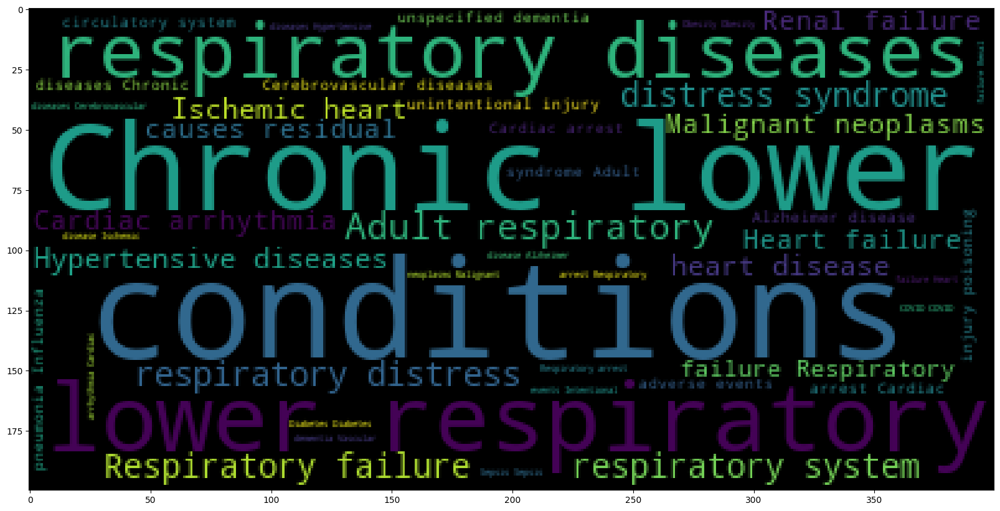

In [41]:
# import word cloud
from wordcloud import WordCloud

sentences = dataset3["Condition"].tolist()
sentences_as_a_string = ' '.join(sentences)


# Convert the string into WordCloud
plt.figure(figsize=(20, 20))
plt.imshow(WordCloud().generate(sentences_as_a_string))

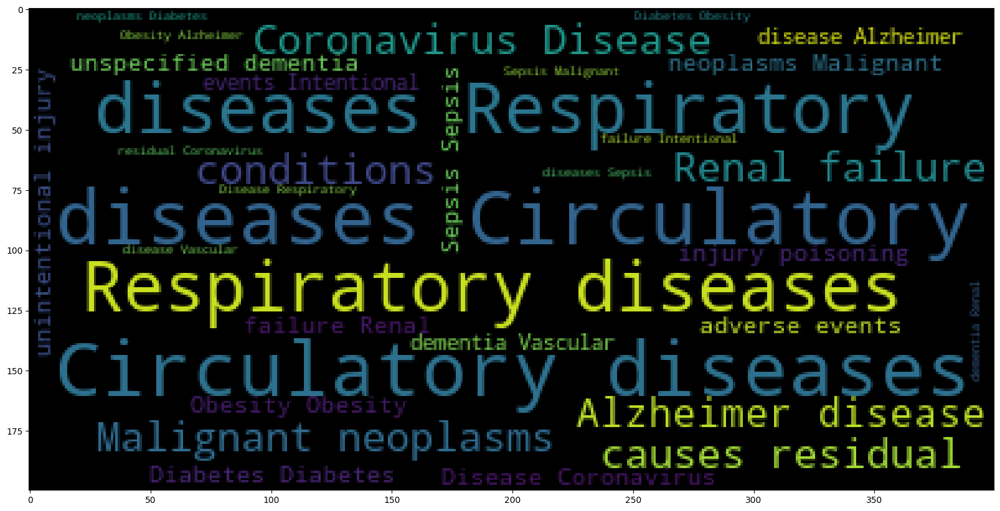

In [42]:
column2_tolist= dataset3["Condition Group"].tolist()

# Convert the list to one single string
column_to_string= " ".join(column2_tolist)

# Convert the string into WordCloud
plt.figure(figsize=(20,20))
plt.imshow(WordCloud().generate(column_to_string))